# Importación Librerías

In [1]:
import pandas as pd
from io import StringIO
import gdown
import json
import os
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import ast
from collections import Counter
from datetime import datetime
import seaborn as sns
import numpy as np
import textwrap


# Reviews Estados - Google

## Carga/Transformaciones

In [4]:
df_reviewsGoogle_CA=pd.read_parquet('../Archivos/ReviewsGoogle_CA.parquet')

### Duplicados

Considerando que una persona no puede realizar dos reviews al mismo tiempo, se considera un dato duplicado aquel que tenga el mismo usuario y el mismo tiempo.

In [5]:
print('Datos duplicados :'+str(df_reviewsGoogle_CA.duplicated(subset=['user_id','time','gmap_id'], keep='first').sum()))

Datos duplicados :75254


Los datos duplicados se eliminarán luego del tratamiento de la columna pics, que tiene una lista

#### largo de pics (duplicados)

In [6]:
# Función para verificar si un valor es un array de numpy
def is_array(x):
    return isinstance(x, np.ndarray)

# Aplicar la función para calcular el largo de los arrays
df_reviewsGoogle_CA['largo_pics'] = df_reviewsGoogle_CA['pics'].apply(lambda x: len(x) if is_array(x) else 0)

In [7]:
df_reviewsGoogle_CA.drop(columns=['pics'], inplace=True)

#### largo de resp (duplicados)

In [8]:
#genero una función para extraer los datos del diccionario
def extract_resp_values(resp):
    if isinstance(resp, dict):
        return resp.get('time', None), resp.get('text', None)
    else:
        return None, None

In [9]:
#la aplico al dataframe
df_reviewsGoogle_CA['resp_time'], df_reviewsGoogle_CA['resp_text'] = zip(*df_reviewsGoogle_CA['resp'].apply(extract_resp_values))

In [10]:
#elimino la columna que ya no me sirve más
df_reviewsGoogle_CA.drop(columns=['resp'], inplace=True)

#### Eliminación de duplicados

In [11]:
df_reviewsGoogle_CA.drop_duplicates(inplace= True)

In [12]:
print('Se eliminaron '+str(2700000-len(df_reviewsGoogle_CA))+' registros duplicados')

Se eliminaron 75242 registros duplicados


### Agregado de columnas temporales

In [13]:
# Función para convertir el timestamp a la hora
def obtener_hora(timestamp):
    dt = datetime.fromtimestamp(timestamp / 1000)  # Convertir de milisegundos a segundos
    return dt.hour

# Aplicar la función a la columna 'time' y crear una nueva columna 'hour'
df_reviewsGoogle_CA['hour'] = df_reviewsGoogle_CA['time'].apply(obtener_hora)

In [14]:
# Función para convertir el timestamp a día de la semana
def obtener_dia_semana(timestamp):
    dt = datetime.fromtimestamp(timestamp / 1000)  # Convertir de milisegundos a segundos
    # dt.weekday() devuelve el día de la semana como un número (0 = lunes, 1 = martes, ..., 6 = domingo)
    return dt.weekday()

# Aplicar la función a la columna 'time' y crear una nueva columna 'weekday'
df_reviewsGoogle_CA['weekday'] = df_reviewsGoogle_CA['time'].apply(obtener_dia_semana)

In [15]:
# Función para convertir el timestamp a día de la semana
def obtener_año(timestamp):
    dt = datetime.fromtimestamp(timestamp / 1000)  # Convertir de milisegundos a segundos
    # dt.weekday() devuelve el día de la semana como un número (0 = lunes, 1 = martes, ..., 6 = domingo)
    return dt.year

# Aplicar la función a la columna 'time' y crear una nueva columna 'weekday'
df_reviewsGoogle_CA['year'] = df_reviewsGoogle_CA['time'].apply(obtener_año)

In [16]:
# Función para convertir el timestamp a día de la semana
def obtener_mes(timestamp):
    dt = datetime.fromtimestamp(timestamp / 1000)  # Convertir de milisegundos a segundos
    # dt.weekday() devuelve el día de la semana como un número (0 = lunes, 1 = martes, ..., 6 = domingo)
    return dt.month

# Aplicar la función a la columna 'time' y crear una nueva columna 'weekday'
df_reviewsGoogle_CA['month'] = df_reviewsGoogle_CA['time'].apply(obtener_mes)

## Analisis

### Nulos

In [57]:
print('Nulos de user_id: '+str(df_reviewsGoogle_CA['user_id'].isnull().sum()))
print('Nulos de name: '+str(df_reviewsGoogle_CA['name'].isnull().sum()))
print('Nulos de time: '+str(df_reviewsGoogle_CA['time'].isnull().sum()))
print('Nulos de rating: '+str(df_reviewsGoogle_CA['rating'].isnull().sum()))
print('Nulos de text: '+str(df_reviewsGoogle_CA['text'].isnull().sum()))
print('Nulos de pics: '+str(len(df_reviewsGoogle_CA[df_reviewsGoogle_CA['largo_pics']==0])))
print('Nulos de resp: '+str(df_reviewsGoogle_CA['resp_text'].isnull().sum()))

Nulos de user_id: 0
Nulos de name: 0
Nulos de time: 0
Nulos de rating: 0
Nulos de text: 1163823
Nulos de pics: 2530146
Nulos de resp: 2386301


### Rating

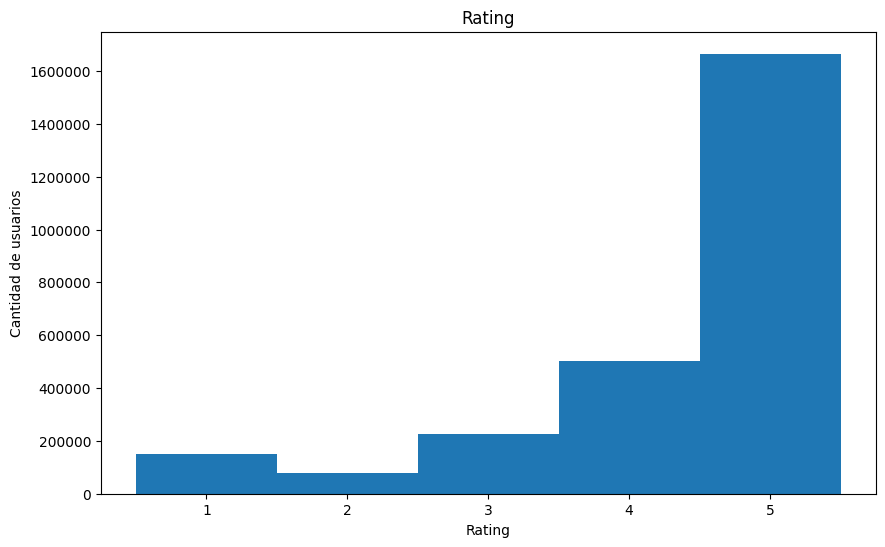

In [58]:
# Tamaño de la figura
plt.figure(figsize=(10, 6))

# Histograma con bins centrados en 1, 2, 3, 4 y 5
plt.hist(df_reviewsGoogle_CA['rating'], bins=range(1, 7), align='left')

# Título del gráfico y etiquetas de los ejes
plt.title('Rating')
plt.ylabel('Cantidad de usuarios')
plt.xlabel('Rating')

# Ajustar el formato del eje y a enteros
plt.gca().get_yaxis().set_major_formatter(ticker.FormatStrFormatter('%d'))

# Establecer los ticks del eje x para mostrar solo los números 1, 2, 3, 4 y 5
plt.xticks(range(1, 6))

#guarda archivo
plt.savefig('../Imagenes/EDA-GoogleMaps/ratingsxreviews.png')

# Mostrar el gráfico
plt.show()

In [21]:
df_reviewsGoogle_CA['rating'].value_counts()/len(df_reviewsGoogle_CA)

rating
5    0.634480
4    0.191662
3    0.086012
1    0.057799
2    0.030047
Name: count, dtype: float64

La mayoría de las reviews suelen puntuar con 5 a los locales.
Un 63% lo hace con ese puntaje, y un 19% con 4.

### pics

In [32]:
(df_reviewsGoogle_CA['largo_pics']==0).sum()/len(df_reviewsGoogle_CA)

0.9639540102363723

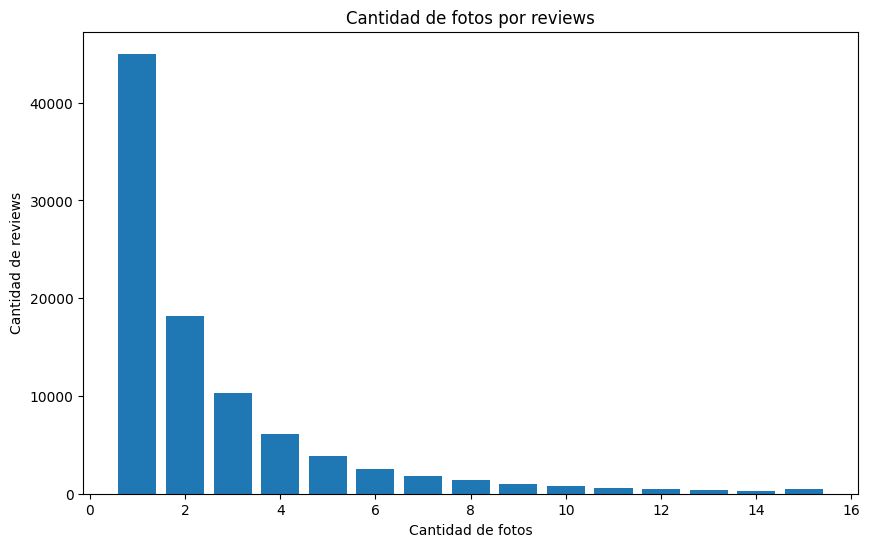

In [30]:
# Tamaño de la figura
plt.figure(figsize=(10, 6))

# Histograma con 15 bins para representar cada valor individualmente en el eje x
plt.hist(df_reviewsGoogle_CA['largo_pics'], bins=range(1, 17), align='left', rwidth=0.8)

# Título del gráfico y etiquetas de los ejes
plt.title('Cantidad de fotos por reviews')
plt.ylabel('Cantidad de reviews')
plt.xlabel('Cantidad de fotos')

# Ajustar el formato del eje y a enteros
plt.gca().get_yaxis().set_major_formatter(ticker.FormatStrFormatter('%d'))

#guarda archivo
plt.savefig('../Imagenes/EDA-GoogleMaps/Fotosxreviews.png')

# Mostrar el gráfico
plt.show()

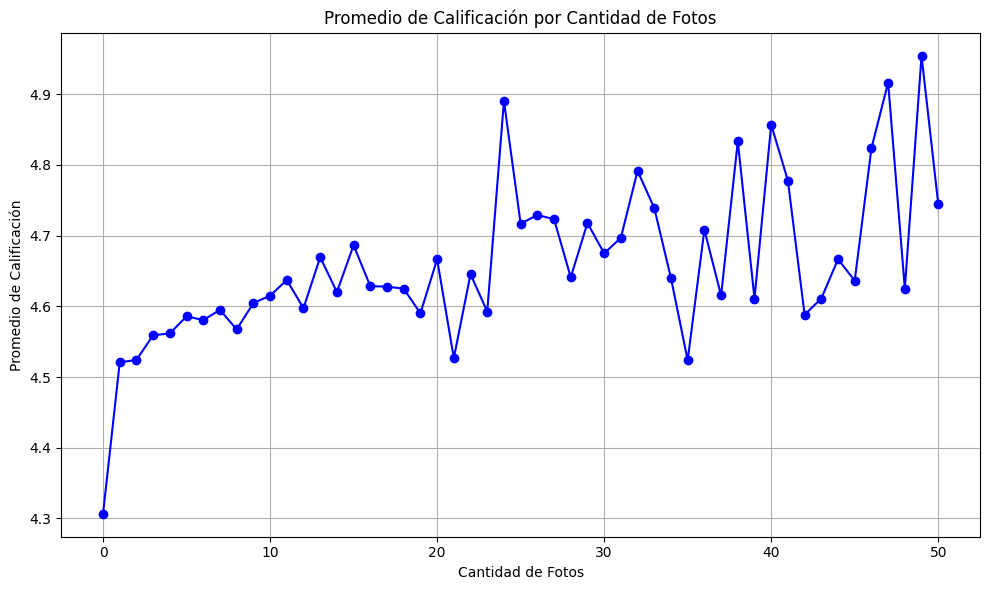

In [34]:
# Calcular el promedio de rating para cada cantidad de fotos
avg_rating_per_pics = df_reviewsGoogle_CA.groupby('largo_pics')['rating'].mean().reset_index()

# Crear el gráfico
plt.figure(figsize=(10, 6))
plt.plot(avg_rating_per_pics['largo_pics'], avg_rating_per_pics['rating'], marker='o', linestyle='-', color='b')

# Personalizar el gráfico
plt.title('Promedio de Calificación por Cantidad de Fotos')
plt.xlabel('Cantidad de Fotos')
plt.ylabel('Promedio de Calificación')
plt.grid(True)

# Ajustar el diseño
plt.tight_layout()

# Guardar la imagen si es necesario
plt.savefig('../Imagenes/EDA-GoogleMaps/promedio_calificacion_por_fotos.png')

# Mostrar el gráfico
plt.show()


### text

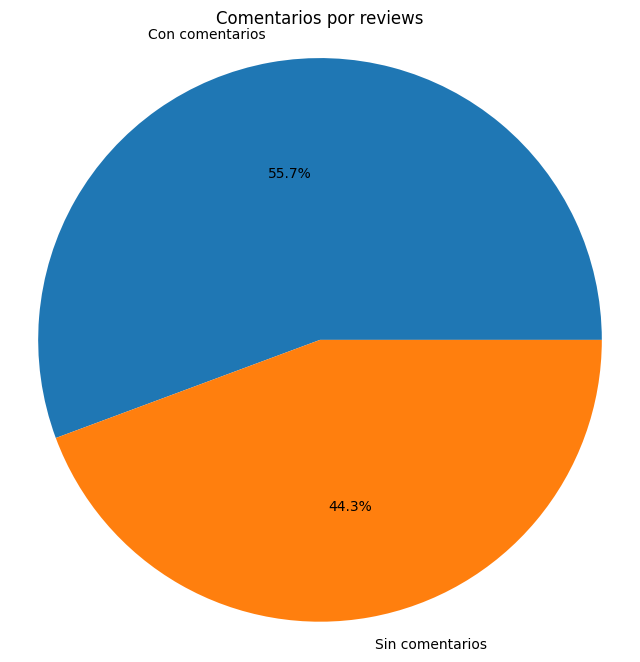

In [28]:
counts=[len(df_reviewsGoogle_CA)-df_reviewsGoogle_CA['text'].isna().sum(),df_reviewsGoogle_CA['text'].isna().sum()]
plt.figure(figsize=(8, 8))
plt.pie(counts, labels=['Con comentarios', 'Sin comentarios'], autopct='%1.1f%%', )
plt.title('Comentarios por reviews')
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.savefig('../Imagenes/EDA-GoogleMaps/Comentariosxreviews.png')
plt.show()

### resp

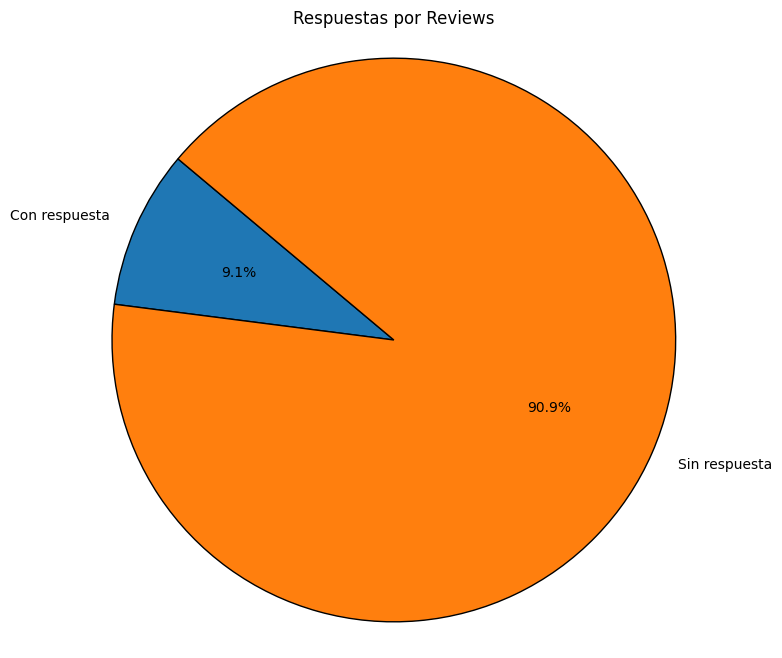

In [26]:
counts=[len(df_reviewsGoogle_CA)-df_reviewsGoogle_CA['resp_text'].isna().sum(),df_reviewsGoogle_CA['resp_text'].isna().sum()]

# Crear el gráfico de pastel
plt.figure(figsize=(8, 8))
plt.pie(counts, 
        labels=['Con respuesta', 'Sin respuesta'], 
        autopct='%1.1f%%',  # Muestra el porcentaje con un decimal
        startangle=140,  # Opcional: Ángulo de inicio del gráfico
        wedgeprops=dict(edgecolor='black'))  # Opcional: Bordes de los segmentos

plt.title('Respuestas por Reviews')
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.savefig('../Imagenes/EDA-GoogleMaps/Respuestasxreviews.png')
plt.show()

### user_id

In [67]:
df_reviewsGoogle_CA['user_id'].nunique()

973518

Los 2.700.000 reviews fueron realizados por 973.518 usuarios

In [64]:
df_reviews.columns

Index(['user_id', 'name', 'time', 'rating', 'text', 'gmap_id', 'largo_pics',
       'resp_time', 'resp_text'],
      dtype='object')

In [36]:
df_reviews_users = df_reviewsGoogle_CA.groupby('user_id').agg({
    'time':'count',
    'text': 'count',
    'rating': 'mean',
    'largo_pics': 'sum',
    'resp_time': 'count',
    # Para contar los valores únicos en una columna, se puede usar 'nunique'
    'gmap_id': pd.Series.nunique
}).reset_index()

# Renombra las columnas para reflejar las métricas calculadas
df_reviews_users.columns = ['user_id', 'count_reviews', 'count_text', 'avg_rating', 'total_pics', 'count_resp', 'count_unique_gmap_id']

#### reviews by user

In [70]:
max(df_reviews_users['count_reviews'])

307

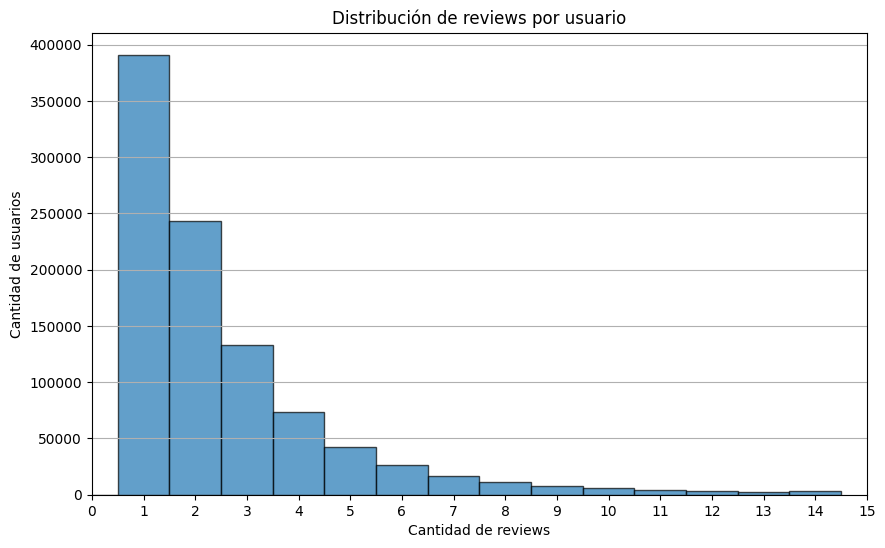

In [37]:
plt.figure(figsize=(10, 6))

# Ajusta los bins para que coincidan con los enteros de 0 a 15
bins = range(16)

plt.hist(df_reviews_users['count_reviews'].dropna(), bins=bins, edgecolor='black', alpha=0.7, align='left')
plt.title('Distribución de reviews por usuario')
plt.ylabel('Cantidad de usuarios')
plt.xlabel('Cantidad de reviews')
plt.xlim(0, 15)

# Asegúrate de que todos los números enteros estén marcados en el eje x
plt.xticks(range(0, 16))

plt.grid(axis='y')

plt.savefig('../Imagenes/EDA-GoogleMaps/reviewsxusuario.png')
plt.show()




#### average rating by user

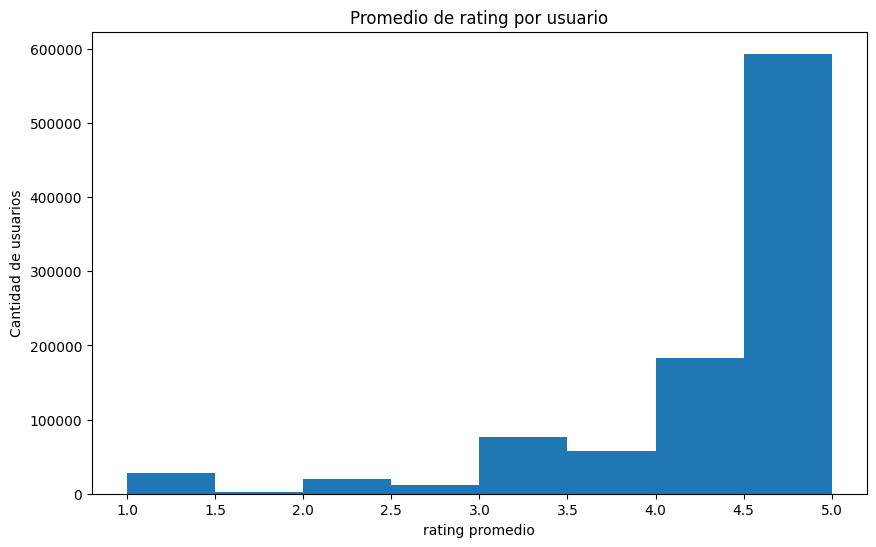

In [73]:
plt.figure(figsize=(10, 6))
plt.hist(df_reviews_users['avg_rating'], bins=8)  # Usa dropna() para excluir valores NaN
plt.title('Promedio de rating por usuario')  # Añade un título al gráfico
plt.ylabel('Cantidad de usuarios')  # Etiqueta para el eje Y
plt.xlabel('rating promedio')  # Etiqueta para el eje Y
plt.savefig('../Imagenes/EDA-GoogleMaps/Ratingxusuario.png')
plt.show()

#### Avg VS reviews

In [37]:
# Calcular la correlación entre avg_rating y count_reviews
correlation = df_reviews_users[['avg_rating', 'count_reviews']].corr().iloc[0, 1]
print(f'Correlación entre avg_rating y count_reviews: {correlation:.2f}')

Correlación entre avg_rating y count_reviews: -0.02


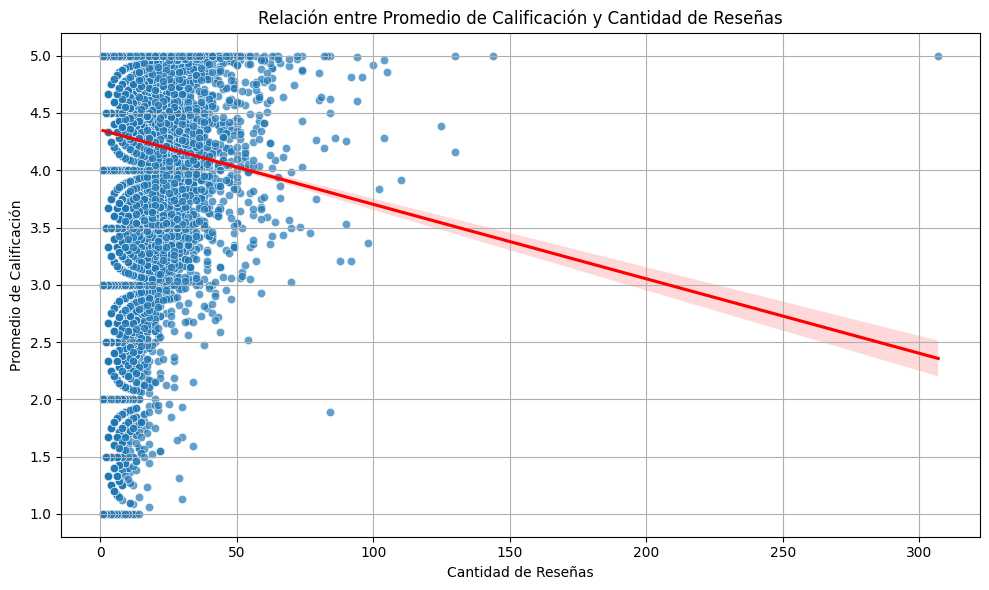

In [38]:
# Crear el diagrama de dispersión
plt.figure(figsize=(10, 6))
sns.scatterplot(x=df_reviews_users['count_reviews'], y=df_reviews_users['avg_rating'], alpha=0.7)

# Añadir línea de regresión para visualizar la tendencia
sns.regplot(x=df_reviews_users['count_reviews'], y=df_reviews_users['avg_rating'], scatter=False, color='red')

# Personalizar el gráfico
plt.title('Relación entre Promedio de Calificación y Cantidad de Reseñas')
plt.xlabel('Cantidad de Reseñas')
plt.ylabel('Promedio de Calificación')
plt.grid(True)

# Ajustar el diseño
plt.tight_layout()

# Guardar la imagen si es necesario
plt.savefig('../Imagenes/EDA-GoogleMaps/correlacion_rating_reseñas.png')

# Mostrar el gráfico
plt.show()


#### pictures by users

In [74]:
max(df_reviews_users['total_pics'])

528

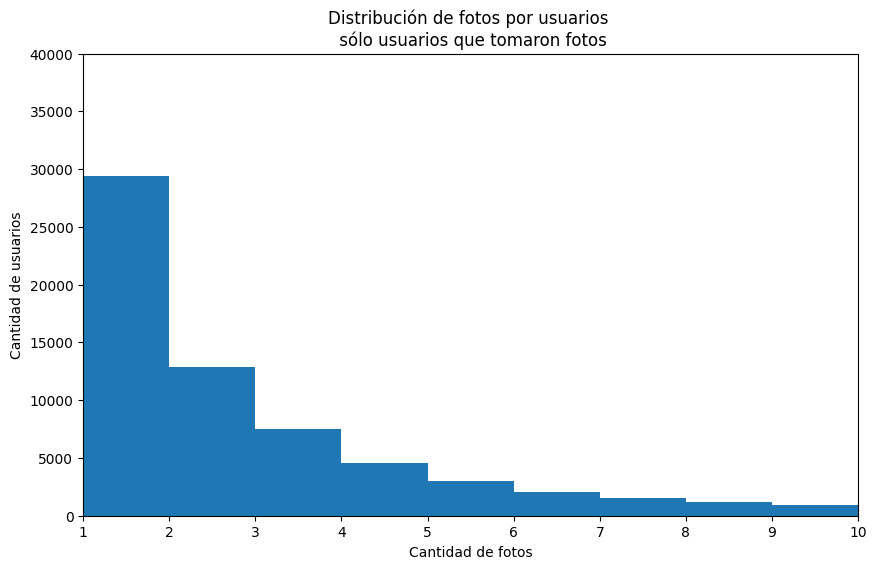

In [75]:
plt.figure(figsize=(10, 6))
plt.hist(df_reviews_users['total_pics'].dropna(),bins=528)  # Usa dropna() para excluir valores NaN
plt.title('Distribución de fotos por usuarios \n sólo usuarios que tomaron fotos')  # Añade un título al gráfico
plt.ylabel('Cantidad de usuarios')  # Etiqueta para el eje Y
plt.ylim(0,40000) 
plt.xlabel('Cantidad de fotos')  # Etiqueta para el eje X
plt.xlim(1,10) 
plt.savefig('../Imagenes/EDA-GoogleMaps/Fotosxusuario.png')
plt.show()

### Rating vs pictures

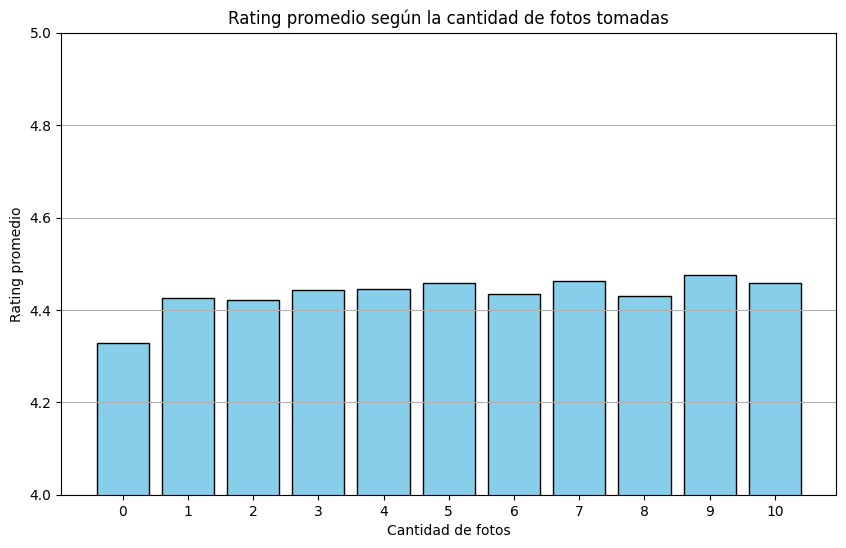

In [35]:
# Asegúrate de que 'total_pics' y 'avg_rating' sean numéricos
df_reviews_users['total_pics'] = pd.to_numeric(df_reviews_users['total_pics'], errors='coerce')
df_reviews_users['avg_rating'] = pd.to_numeric(df_reviews_users['avg_rating'], errors='coerce')

# Filtra los datos para incluir solo usuarios con hasta 10 fotos
df_filtered = df_reviews_users[(df_reviews_users['total_pics'] <= 10) & df_reviews_users['total_pics'].notna()]

# Excluye valores NaN y agrupa por 'total_pics', calculando el rating promedio para cada grupo
avg_ratings = df_filtered.dropna(subset=['avg_rating']).groupby('total_pics')['avg_rating'].mean()

plt.figure(figsize=(10, 6))
plt.bar(avg_ratings.index, avg_ratings.values, color='skyblue', edgecolor='black')
plt.title('Rating promedio según la cantidad de fotos tomadas')
plt.xlabel('Cantidad de fotos')
plt.ylabel('Rating promedio')
plt.ylim(4, 5)  # El rating generalmente está en una escala de 0 a 5

# Asegúrate de que todas las cantidades de fotos estén marcadas en el eje x
plt.xticks(ticks=avg_ratings.index, labels=avg_ratings.index)

plt.grid(axis='y')

plt.savefig('../Imagenes/EDA-GoogleMaps/RatingxFotos.png')
plt.show()

del df_filtered
del avg_ratings


### Rating vs reviews

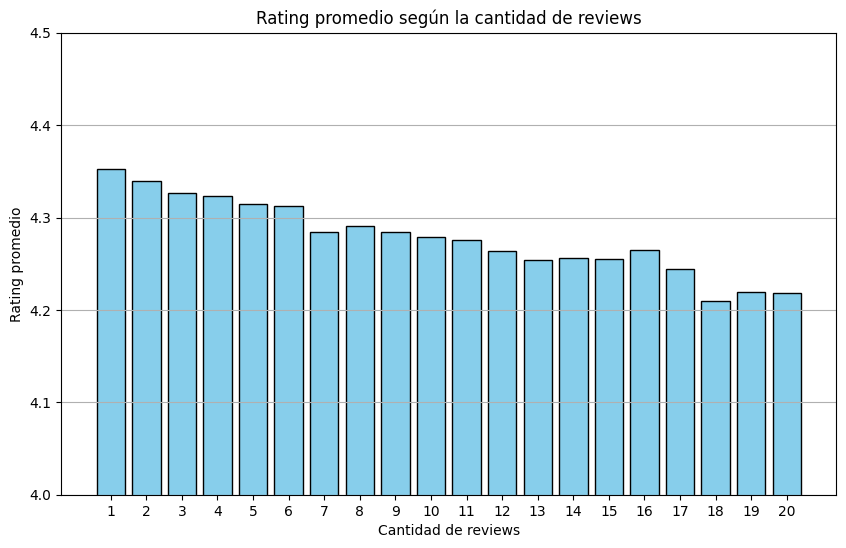

In [42]:
# Asegúrate de que 'count_reviews' y 'avg_rating' sean numéricos
df_reviews_users['count_reviews'] = pd.to_numeric(df_reviews_users['count_reviews'], errors='coerce')
df_reviews_users['avg_rating'] = pd.to_numeric(df_reviews_users['avg_rating'], errors='coerce')


# Filtra los datos para incluir solo usuarios con hasta 15 reviews
df_filtered = df_reviews_users[(df_reviews_users['count_reviews'] <= 20) & df_reviews_users['total_pics'].notna()]

# Excluye valores NaN y agrupa por 'count_reviews', calculando el rating promedio para cada grupo
avg_ratings = df_filtered.dropna(subset=['avg_rating']).groupby('count_reviews')['avg_rating'].mean()

plt.figure(figsize=(10, 6))
plt.bar(avg_ratings.index, avg_ratings.values, color='skyblue', edgecolor='black')
plt.title('Rating promedio según la cantidad de reviews')
plt.xlabel('Cantidad de reviews')
plt.ylabel('Rating promedio')
plt.ylim(4, 4.5)  # El rating generalmente está en una escala de 0 a 5

# Asegúrate de que todas las cantidades de fotos estén marcadas en el eje x
plt.xticks(ticks=avg_ratings.index, labels=avg_ratings.index)

plt.grid(axis='y')

plt.savefig('../Imagenes/EDA-GoogleMaps/RatingxFotos.png')
plt.show()

del avg_ratings

### Analisis temporal

#### Hora

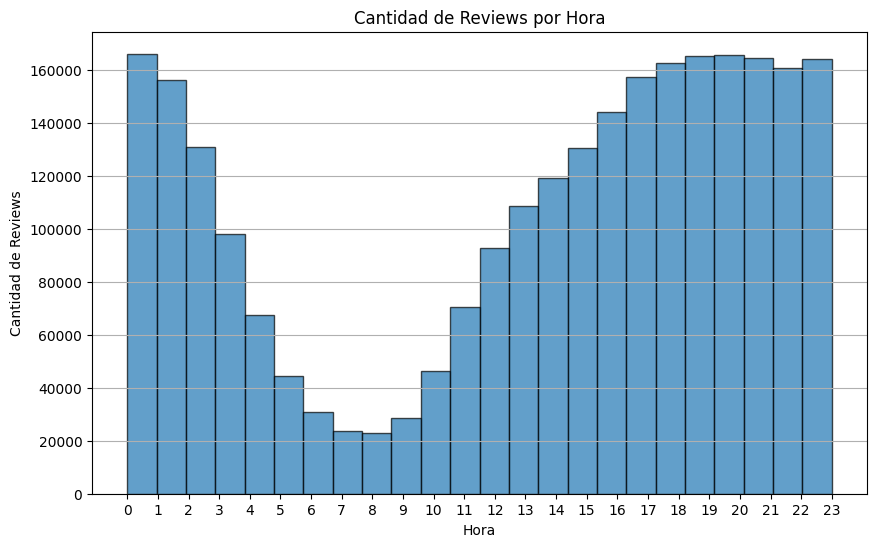

In [18]:
plt.figure(figsize=(10, 6))
plt.hist(df_reviewsGoogle_CA['hour'], bins=24, edgecolor='black', alpha=0.7)
plt.title('Cantidad de Reviews por Hora')
plt.xlabel('Hora')
plt.ylabel('Cantidad de Reviews')
plt.xticks(range(0, 24))  # Asegura que todas las horas de 0 a 23 estén marcadas en el eje x
plt.grid(axis='y')

plt.savefig('../Imagenes/EDA-GoogleMaps/reviewsxhora.png')
plt.show()

#### Dia de la semana

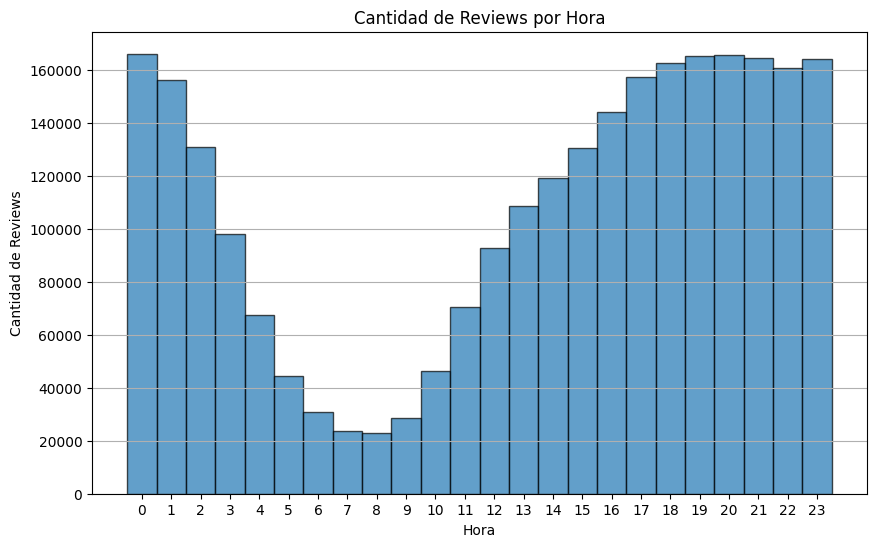

In [26]:
# Asegúrate de que 'hour' sea de tipo entero para un correcto manejo de las horas
df_reviewsGoogle_CA['hour'] = df_reviewsGoogle_CA['hour'].astype(int)

plt.figure(figsize=(10, 6))
plt.hist(df_reviewsGoogle_CA['hour'], bins=range(25), edgecolor='black', alpha=0.7, align='left')
plt.title('Cantidad de Reviews por Hora')
plt.xlabel('Hora')
plt.ylabel('Cantidad de Reviews')
plt.xticks(range(0, 24))  # Asegura que todas las horas de 0 a 23 estén marcadas en el eje x
plt.grid(axis='y')

plt.savefig('../Imagenes/EDA-GoogleMaps/reviewsxhora.png')
plt.show()

#### Año

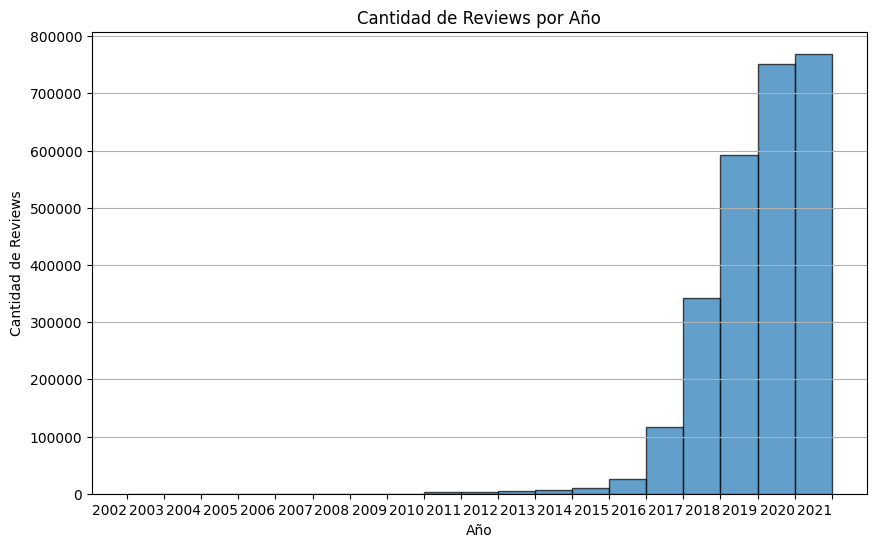

In [57]:
minimo = df_reviewsGoogle_CA[df_reviewsGoogle_CA['year'] != 1990]['year'].min()
maximo = df_reviewsGoogle_CA[df_reviewsGoogle_CA['year'] != 1990]['year'].max()
datos = df_reviewsGoogle_CA[df_reviewsGoogle_CA['year'] != 1990]['year']

plt.figure(figsize=(10, 6))
plt.hist(datos, bins=maximo - minimo, edgecolor='black', alpha=0.7)
plt.title('Cantidad de Reviews por Año')
plt.xlabel('Año')
plt.ylabel('Cantidad de Reviews')

# Alineación de las etiquetas del eje x
plt.xticks(range(minimo, maximo + 1), rotation=0, ha='right')

plt.grid(axis='y')

# Guardar la imagen
plt.savefig('../Imagenes/EDA-GoogleMaps/reviewsxanio.png')
plt.show()

del datos

### mes por año

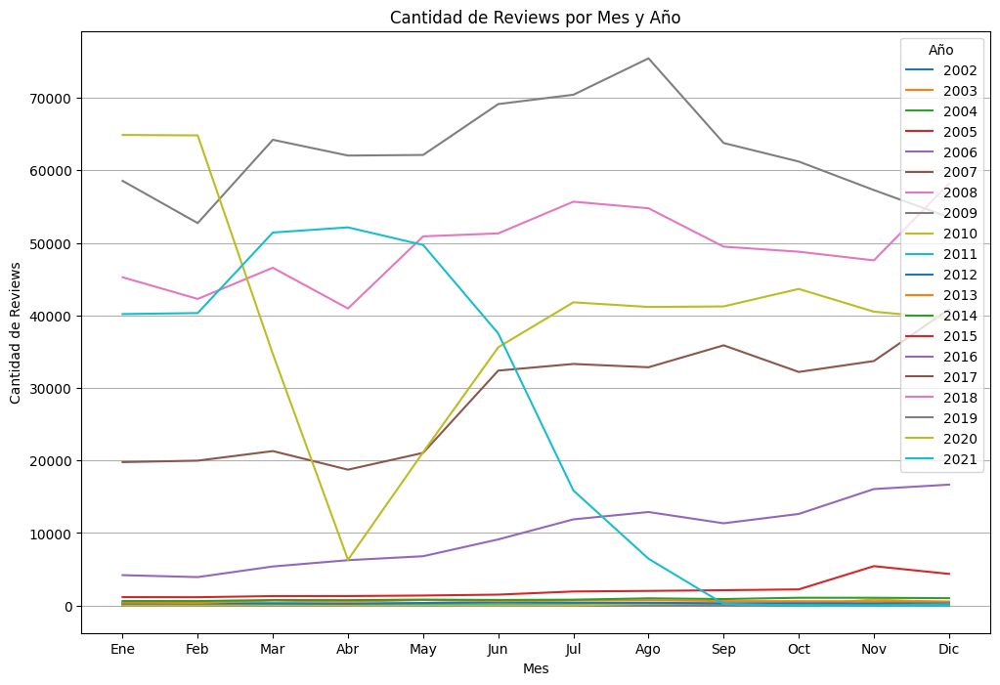

In [38]:
# Supongo que ya has cargado tu DataFrame df_reviewsGoogle_CA

# Filtrar los datos
df_filtered = df_reviewsGoogle_CA[df_reviewsGoogle_CA['year'] != 1990]

# Agrupar los datos por año y mes, contando la cantidad de reviews por cada combinación
df_grouped = df_filtered.groupby(['year', 'month']).size().reset_index(name='counts')

# Pivoteando el DataFrame para que cada año tenga su propia columna
df_pivot = df_grouped.pivot(index='month', columns='year', values='counts').fillna(0)

# Crear el gráfico de líneas
plt.figure(figsize=(12, 8))

for year in df_pivot.columns:
    plt.plot(df_pivot.index, df_pivot[year], label=year)

plt.title('Cantidad de Reviews por Mes y Año')
plt.xlabel('Mes')
plt.ylabel('Cantidad de Reviews')
plt.xticks(range(1, 13), ['Ene', 'Feb', 'Mar', 'Abr', 'May', 'Jun', 'Jul', 'Ago', 'Sep', 'Oct', 'Nov', 'Dic'])
plt.legend(title='Año')
plt.grid(axis='y')

# Guardar la imagen
plt.savefig('../Imagenes/EDA-GoogleMaps/reviews_por_mes_y_ano.png')
plt.show()


In [39]:
del df_filtered
del df_grouped
del df_pivot

# Metadatos - Google

## Carga/Transformaciones

In [41]:
df_metadatos_CA=pd.read_parquet('../Archivos/metadatos_CA.parquet')

### Duplicados

In [42]:
df_metadatos_CA.drop_duplicates(subset='gmap_id', inplace=True)
df_metadatos_CA.reset_index(inplace=True)
df_metadatos_CA.drop(columns='index', inplace=True)

### Misc

Se explota la columna MISC en varias columnas

In [43]:
def expand_dict_to_columns(row):
    if pd.isnull(row):
        return pd.Series()
    
    expanded_dict = {}
    for key, value in row.items():
        if isinstance(value, np.ndarray):
            expanded_dict[key] = list(value)
        else:
            expanded_dict[key] = value
    
    return pd.Series(expanded_dict)

# Aplicar la función a la columna 'MISC'
df_misc_expanded = df_metadatos_CA['MISC'].apply(expand_dict_to_columns)

# Combinar con el DataFrame original
df_metadatos_CA = pd.concat([df_metadatos_CA, df_misc_expanded], axis=1)

# Eliminar la columna original 'MISC' si ya no es necesaria
df_metadatos_CA.drop(columns=['MISC'], inplace=True)

del df_misc_expanded

### General Category

In [44]:
def generalize_category(category_array):
    auto_keywords = ["auto", "car", "gas station", "parking", "vehicle", "tire"]
    beauty_keywords = ["beauty", "hair", "nail", "cosmetic", "spa", "salon", "massage"]
    clothes_keywords = ["clothing", "shoe", "boutique", "fashion"]
    health_keywords = ["hospital", "clinic", "doctor", "pharmacy", "dental", "health", "medical", "nurse", "vet", "veterinary", 'dentist']
    home_keywords = ["home", "furniture", "garden", "real estate", "property", "plumber", "electrician", "construction", 'laundromat', "dry cleaner"]
    food_keywords = ["restaurant", "cafe", "bakery", "grocery", "supermarket", "food", "bar", "pub", "pizza"]
    entertainment_keywords = ["theater", "cinema", "museum", "park", "zoo", "amusement", "casino", 'art gallery']
    education_keywords = ["school", "university", "college", "library", "education", "learning", "academy"]
    services_keywords = ["bank", "insurance", "consulting", "lawyer", "attorney", "service", "repair", "maintenance", "laundry", "post office"]
    sports_keywords = ["gym", "fitness", "sport", "stadium", "arena", "athletic"]
    technology_keywords = ["it", "tech", "technology", "computer", "software", "hardware", "electronics", "telecom"]
    religion_keywords = ["synagogue", "church", "buddhist", "mosque", "religious"]
    stores_keywords = ['liquor store', 'convenience store', 'store', 'coffee shop', 'shopping mall', 'cell phone store', 'florist', "fabric store", "shop", 'jeweler']
    buildings_keywords = ['corporate office', 'apartment', 'condominium', 'hotel', 'store', 'coffee shop', 'shopping mall', 'cell phone store', 'florist', "fabric store", "shop"]

    # Convertir el array de NumPy a una lista de cadenas
    if isinstance(category_array, np.ndarray):
        categories = category_array.tolist()
    elif isinstance(category_array, str):
        # En caso de que sea una cadena, convertir a lista usando ast.literal_eval
        try:
            categories = ast.literal_eval(category_array)
        except (ValueError, SyntaxError):
            return "Other"
    else:
        return "Other"

    # Convertir todas las categorías a minúsculas
    categories = [cat.strip().lower() for cat in categories]

    # Verificar qué categoría coincide
    for category, keywords in {
        "Auto": auto_keywords,
        "Beauty": beauty_keywords,
        "Clothes": clothes_keywords,
        "Health": health_keywords,
        "Home": home_keywords,
        "Food": food_keywords,
        "Entertainment": entertainment_keywords,
        "Education": education_keywords,
        "Services": services_keywords,
        "Sports": sports_keywords,
        "Technology": technology_keywords,
        "Religion": religion_keywords,
        "Stores": stores_keywords,
        "Buildings": buildings_keywords
    }.items():
        if any(keyword in ' '.join(categories) for keyword in keywords):
            print(f"Coincide con: {category} (Palabras clave: {keywords})")
            return category

    return "Other"

# Aplicar la función al DataFrame
df_metadatos_CA['general_category'] = df_metadatos_CA['category'].apply(generalize_category)

# Mostrar algunos resultados para verificar
print(df_metadatos_CA[['category', 'general_category']].head(20))

Coincide con: Food (Palabras clave: ['restaurant', 'cafe', 'bakery', 'grocery', 'supermarket', 'food', 'bar', 'pub', 'pizza'])
Coincide con: Stores (Palabras clave: ['liquor store', 'convenience store', 'store', 'coffee shop', 'shopping mall', 'cell phone store', 'florist', 'fabric store', 'shop', 'jeweler'])
Coincide con: Stores (Palabras clave: ['liquor store', 'convenience store', 'store', 'coffee shop', 'shopping mall', 'cell phone store', 'florist', 'fabric store', 'shop', 'jeweler'])
Coincide con: Stores (Palabras clave: ['liquor store', 'convenience store', 'store', 'coffee shop', 'shopping mall', 'cell phone store', 'florist', 'fabric store', 'shop', 'jeweler'])
Coincide con: Food (Palabras clave: ['restaurant', 'cafe', 'bakery', 'grocery', 'supermarket', 'food', 'bar', 'pub', 'pizza'])
Coincide con: Services (Palabras clave: ['bank', 'insurance', 'consulting', 'lawyer', 'attorney', 'service', 'repair', 'maintenance', 'laundry', 'post office'])
Coincide con: Beauty (Palabras cl

## Analisis

### Category

In [80]:
# la columna figura con listas, pero con formato str. Paso primero a lista los str, para luego poder trabajar sobre ellos.
# Esto sucede sólo cuando lo importamos del csv 

def safe_literal_eval(val):
    try:
        return ast.literal_eval(val)
    except (ValueError, SyntaxError):
        return val


df_metadatos_CA['category'] = df_metadatos_CA['category'].apply(safe_literal_eval)

# Expandir las listas en filas individuales
categorias_expandidas = df_metadatos_CA['category'].explode()

# Contar las ocurrencias de cada categoría
conteo_categorias = categorias_expandidas.value_counts()

In [81]:
conteo_categorias.head(40)

category
Restaurant                 11505
Auto repair shop            8729
Beauty salon                7846
Hair salon                  5526
Nail salon                  5419
Convenience store           4892
Gas station                 4770
Park                        4047
Clothing store              3991
Barber shop                 3879
Dentist                     3836
Church                      3684
ATM                         3684
Tourist attraction          3415
Mexican restaurant          3395
Cell phone store            3353
Grocery store               3328
Fast food restaurant        3040
Tire shop                   2955
Cafe                        2946
Massage therapist           2895
Doctor                      2881
Non-profit organization     2866
Coffee shop                 2823
Corporate office            2768
Insurance agency            2721
Sandwich shop               2686
Gift shop                   2534
Brake shop                  2513
Women's clothing store      2505
A

##### Agrupacion por categoría

In [41]:
# Función para asegurarse de que todos los elementos sean listas de cadenas de texto
def ensure_list_of_strings(x):
    if isinstance(x, np.ndarray):
        return x.tolist()
    elif isinstance(x, list):
        return x
    elif x is not None:
        return [x]
    else:
        return []

# Aplicar la función a la columna 'category'
df_metadatos_CA['category'] = df_metadatos_CA['category'].apply(ensure_list_of_strings)

# Convertir todos los elementos de la lista a texto y unirlos en una cadena
df_metadatos_CA['category'] = df_metadatos_CA['category'].apply(lambda x: ', '.join(map(str, x)))

In [42]:
df_categories=df_metadatos_CA.groupby('category').agg({
    'gmap_id':'count', 
    'avg_rating': 'mean',
    'num_of_reviews': 'sum',
}).reset_index()

In [43]:
df_categories.columns = ['category', 'stores', 'avg_rating', 'num_of_reviews']

In [44]:
df_categories['category'].nunique()

54162

In [45]:
df_categories['category'].unique()

array(['',
       '3D printing service, Architectural and engineering model maker, Industrial design company, Manufacturer, Model design company',
       'ATM', ..., 'Zoo, Tourist attraction',
       'Zoo, Tourist attraction, Wildlife refuge', 'Zoo, Wildlife refuge'],
      dtype=object)

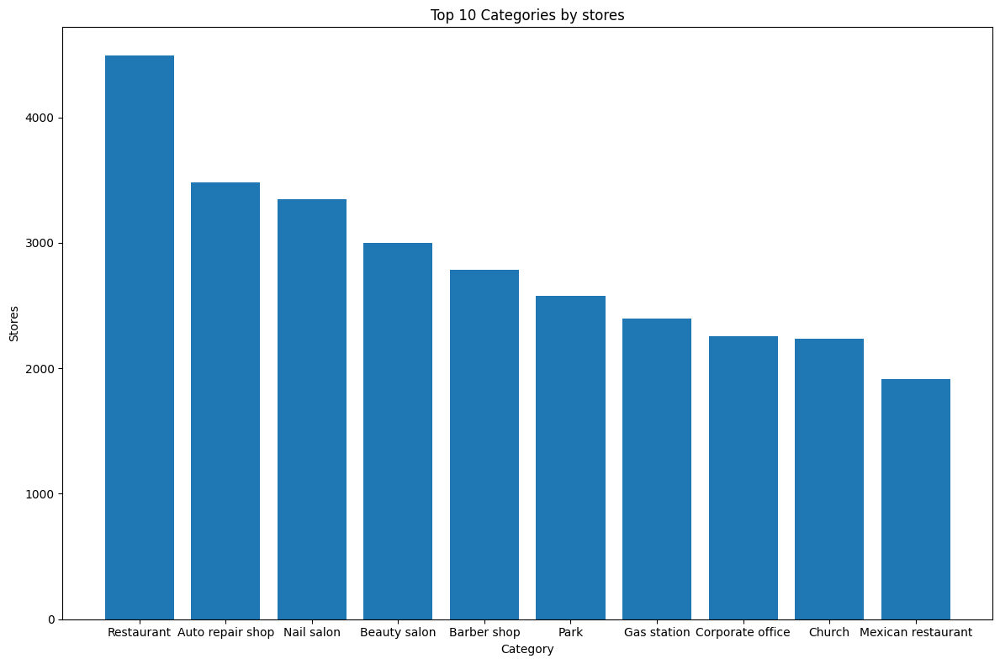

In [47]:
# Ordenar el DataFrame por avg_rating en orden descendente y seleccionar las diez primeras categorías
top_categories = df_categories.sort_values(by='stores', ascending=False).head(10)

# Crear el gráfico de barras
plt.figure(figsize=(12, 8))
plt.bar(top_categories['category'], top_categories['stores'])
plt.xlabel('Category')
plt.ylabel('Stores')
plt.title('Top 10 Categories by stores')
plt.xticks(rotation=0)
plt.tight_layout()

#Guardar el grafico
plt.savefig('../Imagenes/EDA-GoogleMaps/storesxcategoria.png')

# Mostrar el gráfico
plt.show()

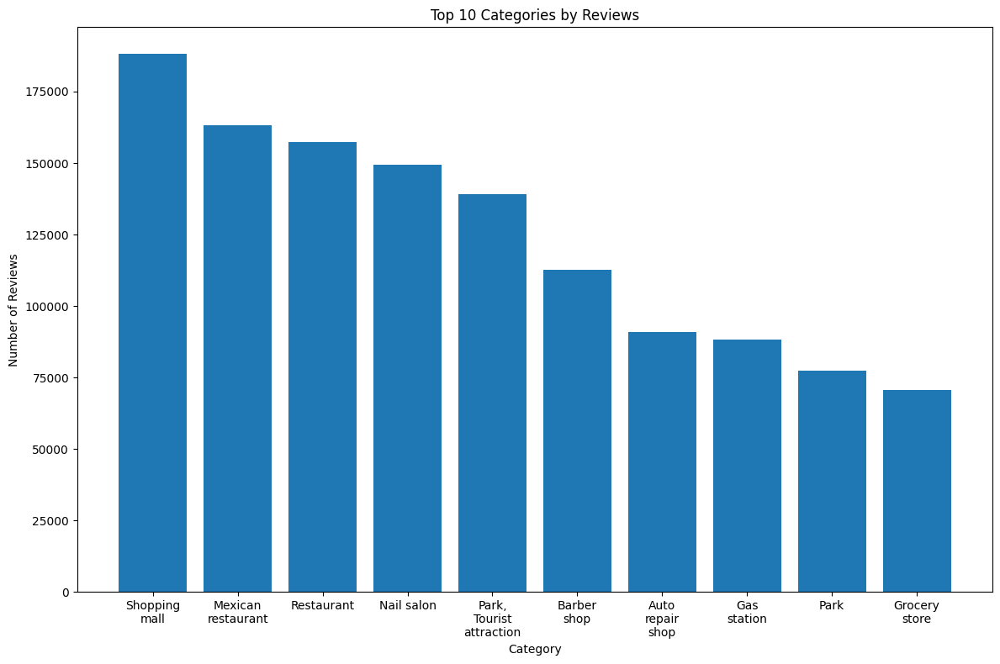

In [51]:
# Ordenar el DataFrame por num_of_reviews en orden descendente y seleccionar las diez primeras categorías
top_categories = df_categories.sort_values(by='num_of_reviews', ascending=False).head(10)

# Envolver las etiquetas de las categorías
wrapped_labels = [textwrap.fill(label, 10) for label in top_categories['category']]

# Crear el gráfico de barras
plt.figure(figsize=(12, 8))
plt.bar(wrapped_labels, top_categories['num_of_reviews'])
plt.xlabel('Category')
plt.ylabel('Number of Reviews')
plt.title('Top 10 Categories by Reviews')
plt.xticks(rotation=0)
plt.tight_layout()

# Guardar el gráfico
plt.savefig('../Imagenes/EDA-GoogleMaps/reviewsxcategoria.png')

# Mostrar el gráfico
plt.show()

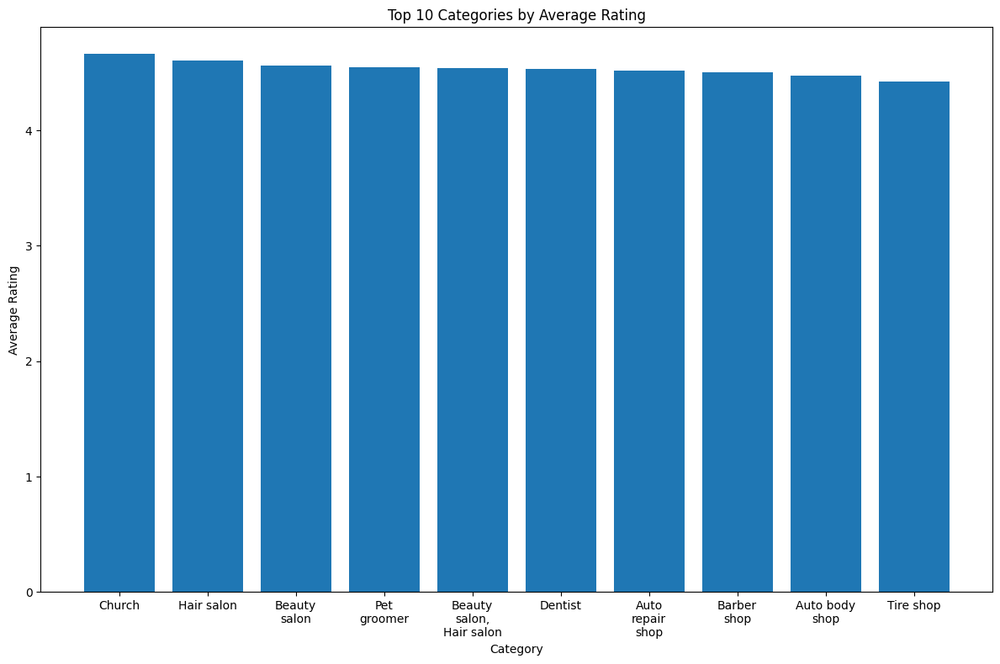

In [54]:
# Ordenar el DataFrame por avg_rating en orden descendente y seleccionar las diez primeras categorías
top_categories = df_categories[df_categories['stores'] > 1000].sort_values(by='avg_rating', ascending=False).head(10)


# Envolver las etiquetas de las categorías
wrapped_labels = [textwrap.fill(label, 10) for label in top_categories['category']]


# Crear el gráfico de barras
plt.figure(figsize=(12, 8))
plt.bar(wrapped_labels, top_categories['avg_rating'])
plt.xlabel('Category')
plt.ylabel('Average Rating')
plt.title('Top 10 Categories by Average Rating')
plt.xticks(rotation=0)
plt.tight_layout()

#Guardar el grafico
plt.savefig('../Imagenes/EDA-GoogleMaps/ratingxcategoria.png')

# Mostrar el gráfico
plt.show()

### General Category

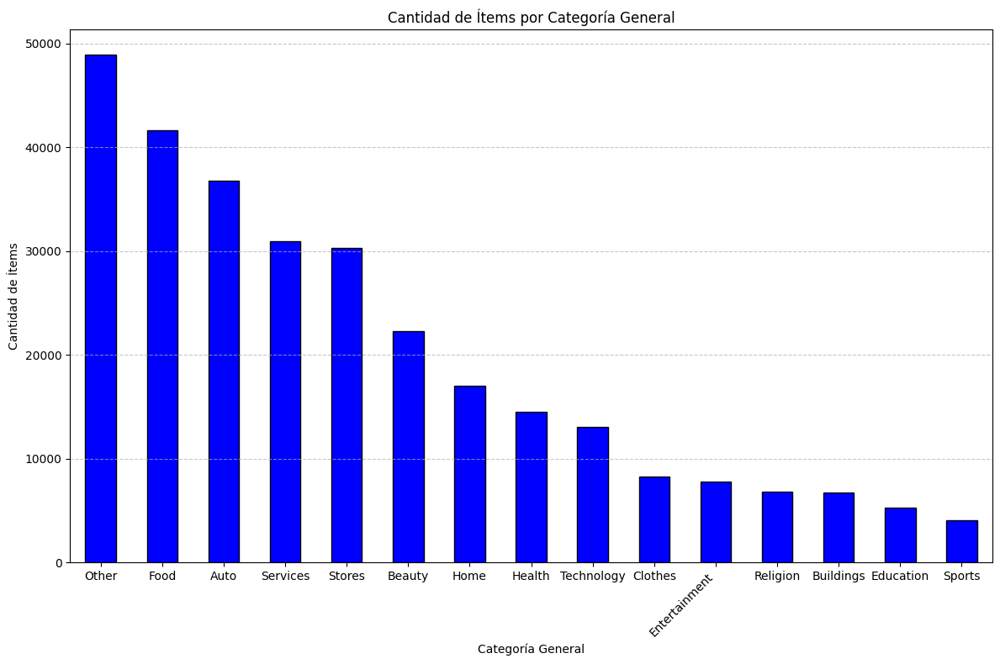

In [24]:
# Contar la frecuencia de cada categoría general
general_category_counts = df_metadatos_CA['general_category'].value_counts()

# Crear el histograma
plt.figure(figsize=(12, 8))
ax = general_category_counts.plot(kind='bar', color='blue', edgecolor='black')

# Personalizar el gráfico
plt.title('Cantidad de Ítems por Categoría General')
plt.xlabel('Categoría General')
plt.ylabel('Cantidad de Ítems')

# Rotar solo la etiqueta "Entertainment"
labels = ax.get_xticklabels()
for label in labels:
    if label.get_text() == 'Entertainment':
        label.set_rotation(45)
        label.set_ha('right')
    else:
        label.set_rotation(0)

plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()

# Guardar la imagen
plt.savefig('../Imagenes/EDA-GoogleMaps/cantidad_por_categoria_general.png')

# Mostrar el gráfico
plt.show()



### MISC

In [65]:
for i in df_metadatos_CA.columns:
   print('Nulos de '+i+': '+str(round(df_metadatos_CA[i].isna().sum()))) 

Nulos de name: 0
Nulos de address: 0
Nulos de gmap_id: 0
Nulos de description: 262864
Nulos de latitude: 0
Nulos de longitude: 0
Nulos de category: 0
Nulos de avg_rating: 0
Nulos de num_of_reviews: 0
Nulos de price: 263155
Nulos de hours: 66506
Nulos de state: 63238
Nulos de relative_results: 23740
Nulos de url: 0
Nulos de estado: 0
Nulos de Accessibility: 78822
Nulos de Activities: 294519
Nulos de Amenities: 235190
Nulos de Atmosphere: 270880
Nulos de Crowd: 276053
Nulos de Dining options: 276565
Nulos de From the business: 285965
Nulos de Getting here: 294474
Nulos de Health & safety: 254078
Nulos de Health and safety: 293157
Nulos de Highlights: 270098
Nulos de Offerings: 248545
Nulos de Payments: 247611
Nulos de Planning: 214561
Nulos de Popular for: 274623
Nulos de Recycling: 294456
Nulos de Service options: 199808


#### Activities

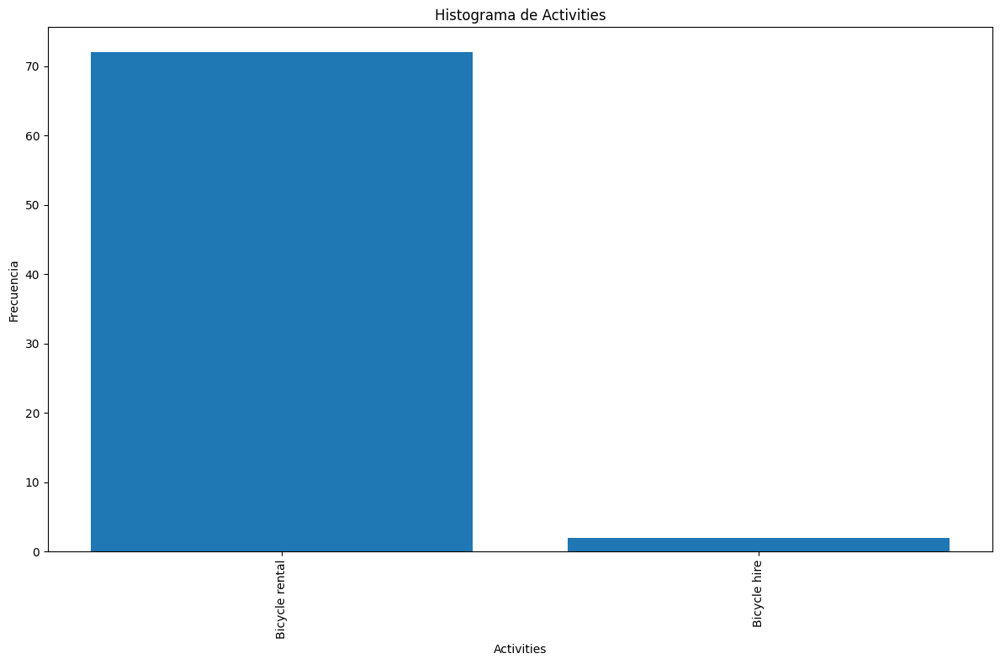

In [72]:
# Asegurarse de que la columna 'Activities' contiene listas y manejar valores no iterables
activities = df_metadatos_CA['Activities'].dropna().apply(lambda x: x if isinstance(x, list) else [])

# Aplanar la lista de actividades
all_activities = [activity for sublist in activities for activity in sublist]

# Contar la frecuencia de cada actividad
activity_counts = Counter(all_activities)

# Convertir el resultado a un DataFrame
df_activity_counts = pd.DataFrame.from_dict(activity_counts, orient='index').reset_index()
df_activity_counts.columns = ['Activity', 'Count']

# Crear el histograma
plt.figure(figsize=(12, 8))
plt.bar(df_activity_counts['Activity'], df_activity_counts['Count'])
plt.xlabel('Activities')
plt.ylabel('Frecuencia')
plt.title('Histograma de Activities')
plt.xticks(rotation=90)
plt.tight_layout()

# Guardar el gráfico
plt.savefig('../Imagenes/EDA-GoogleMaps/histograma_activities.png')

# Liberar memoria
del df_activity_counts
del all_activities
del activity_counts

# Mostrar el gráfico
plt.show()


#### Accesibility

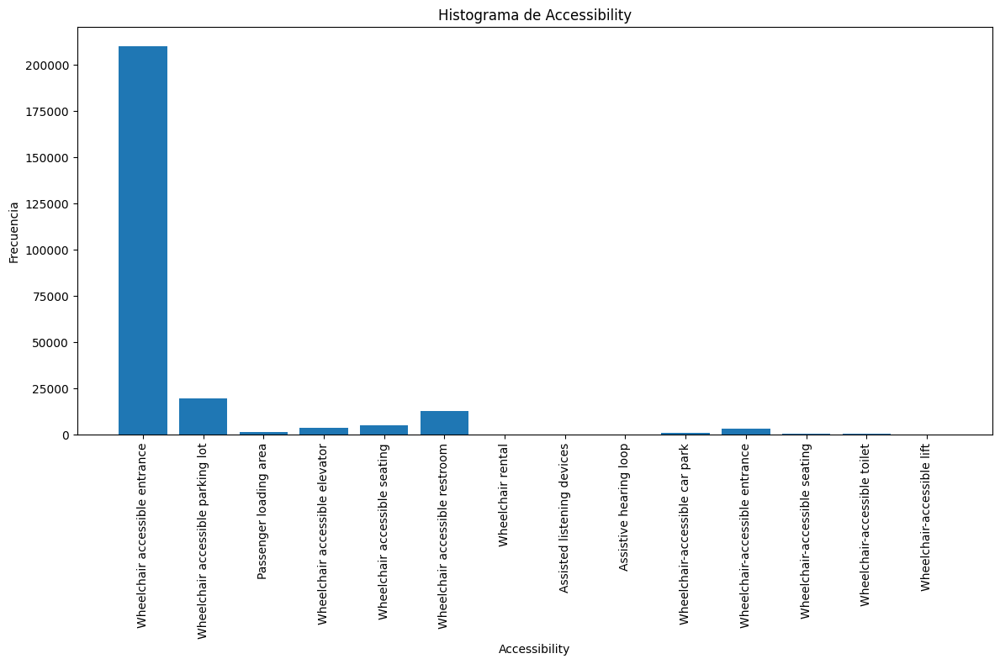

In [74]:
# Asegurarse de que la columna 'Accessibility' contiene listas y manejar valores no iterables
accessibilities = df_metadatos_CA['Accessibility'].dropna().apply(lambda x: x if isinstance(x, list) else [])

# Aplanar la lista de accesibilidades
all_access = []
for sublist in accessibilities:
    if isinstance(sublist, list):
        all_access.extend(sublist)

# Contar la frecuencia de cada accesibilidad
access_counts = Counter(all_access)

# Convertir el resultado a un DataFrame
df_access_counts = pd.DataFrame.from_dict(access_counts, orient='index').reset_index()
df_access_counts.columns = ['Accessibility', 'Count']

# Crear el histograma
plt.figure(figsize=(12, 8))
plt.bar(df_access_counts['Accessibility'], df_access_counts['Count'])
plt.xlabel('Accessibility')
plt.ylabel('Frecuencia')
plt.title('Histograma de Accessibility')
plt.xticks(rotation=90)
plt.tight_layout()

# Guardar el gráfico
plt.savefig('../Imagenes/EDA-GoogleMaps/histograma_accessibility.png')

# Liberar memoria
del df_access_counts
del all_access
del access_counts

# Mostrar el gráfico
plt.show()


In [64]:
for i in df_metadatos_CA.columns:
   print('Nulos de '+i+': '+str(round(df_metadatos_CA[i].isna().sum()/len(df_metadatos_CA)*100,0))+' %') 

Nulos de name: 0.0 %
Nulos de address: 0.0 %
Nulos de gmap_id: 0.0 %
Nulos de description: 89.0 %
Nulos de latitude: 0.0 %
Nulos de longitude: 0.0 %
Nulos de category: 0.0 %
Nulos de avg_rating: 0.0 %
Nulos de num_of_reviews: 0.0 %
Nulos de price: 89.0 %
Nulos de hours: 23.0 %
Nulos de state: 21.0 %
Nulos de relative_results: 8.0 %
Nulos de url: 0.0 %
Nulos de estado: 0.0 %
Nulos de Accessibility: 27.0 %
Nulos de Activities: 100.0 %
Nulos de Amenities: 80.0 %
Nulos de Atmosphere: 92.0 %
Nulos de Crowd: 94.0 %
Nulos de Dining options: 94.0 %
Nulos de From the business: 97.0 %
Nulos de Getting here: 100.0 %
Nulos de Health & safety: 86.0 %
Nulos de Health and safety: 100.0 %
Nulos de Highlights: 92.0 %
Nulos de Offerings: 84.0 %
Nulos de Payments: 84.0 %
Nulos de Planning: 73.0 %
Nulos de Popular for: 93.0 %
Nulos de Recycling: 100.0 %
Nulos de Service options: 68.0 %


### Rating vs reviews

In [96]:
x=df_metadatos_CA['num_of_reviews']
y=df_metadatos_CA['avg_rating']

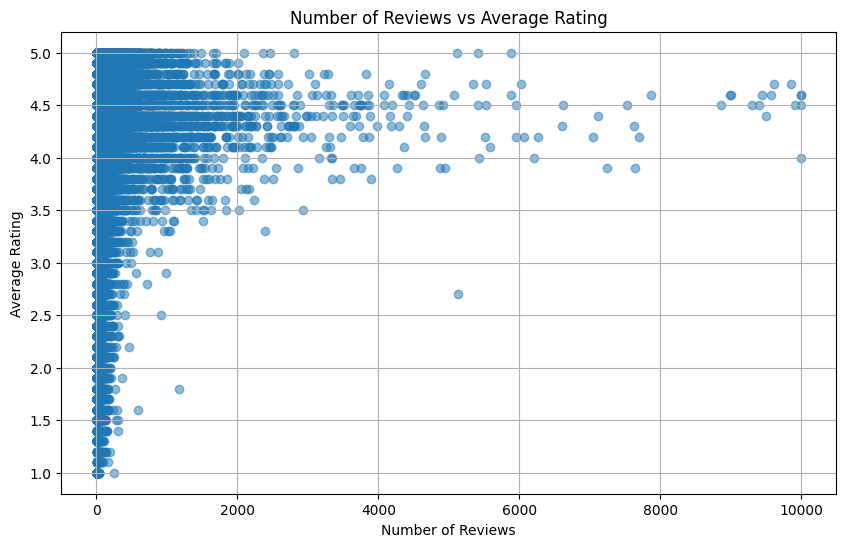

In [98]:
plt.figure(figsize=(10, 6))  # Adjust the figure size as needed
plt.scatter(x, y, alpha=0.5)  # Create scatter plot with transparency

plt.title('Number of Reviews vs Average Rating')
plt.xlabel('Number of Reviews')
plt.ylabel('Average Rating')

plt.savefig('../Imagenes/EDA-GoogleMaps/reviewsxvsrating.png')

plt.grid(True)  # Add gridlines for better readability
plt.show()

### Otro

# Reviews and Metadata (Google)

## Agregar datos de Metadata a Reviews

In [45]:
df_reviewsGoogle_CA = pd.merge(df_reviewsGoogle_CA, df_metadatos_CA, on='gmap_id', how='left')

In [46]:
df_reviewsGoogle_CA.columns

Index(['user_id', 'name_x', 'time', 'rating', 'text', 'gmap_id', 'largo_pics',
       'resp_time', 'resp_text', 'hour', 'weekday', 'year', 'month', 'name_y',
       'address', 'description', 'latitude', 'longitude', 'category',
       'avg_rating', 'num_of_reviews', 'price', 'hours', 'state',
       'relative_results', 'url', 'estado', 'Accessibility', 'Activities',
       'Amenities', 'Atmosphere', 'Crowd', 'Dining options',
       'From the business', 'Getting here', 'Health & safety',
       'Health and safety', 'Highlights', 'Offerings', 'Payments', 'Planning',
       'Popular for', 'Recycling', 'Service options', 'general_category'],
      dtype='object')

## Analisis

#### Diferencias

In [48]:
# Agrupar por 'gmap' y calcular las métricas requeridas
grouped_df = df_reviewsGoogle_CA.groupby('gmap_id').agg(
    rat_rev=('rating', 'mean'),  # Promedio de 'rating'
    rev_rev=('gmap_id', 'count'),  # Conteo de 'gmap_id'
    avg_rating=('avg_rating', 'mean'),  
    num_meta=('num_of_reviews', 'mean')
).reset_index()

# Calcular diferencias
grouped_df['dif_rev'] = grouped_df['rev_rev'] - grouped_df['num_meta']
grouped_df['dif_rat'] = grouped_df['rat_rev'] - grouped_df['avg_rating']

In [49]:
grouped_df['dif_rev'].describe()

count    72634.000000
mean       -36.482088
std         90.279820
min      -5384.000000
25%        -31.000000
50%        -16.000000
75%         -8.000000
max          0.000000
Name: dif_rev, dtype: float64

In [50]:
grouped_df['dif_rat'].describe()

count    72634.000000
mean         0.044338
std          0.266527
min         -2.500000
25%         -0.092308
50%          0.021212
75%          0.166667
max          2.828571
Name: dif_rat, dtype: float64

### Accesibility

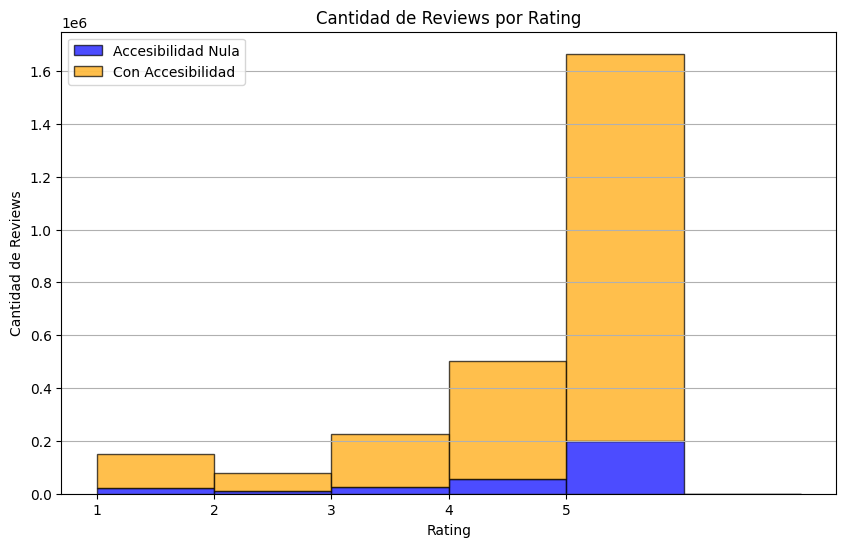

In [26]:
    # Filtrar los datos
accessibility_null = df_reviewsGoogle_CA[df_reviewsGoogle_CA['Accessibility'].isna()]
accessibility_not_null = df_reviewsGoogle_CA[df_reviewsGoogle_CA['Accessibility'].notna()]
    
    # Crear el histograma con barras apiladas
plt.figure(figsize=(10, 6))
plt.hist([accessibility_null['rating'], accessibility_not_null['rating']], bins=range(1, 8), edgecolor='black', alpha=0.7, label=['Accesibilidad Nula', 'Con Accesibilidad'], stacked=True, color=['blue', 'orange'])
plt.title('Cantidad de Reviews por Rating')
plt.xlabel('Rating')
plt.ylabel('Cantidad de Reviews')
plt.xticks(range(1, 6))  # Asegura que los ratings de 1 a 5 estén marcados en el eje x
plt.grid(axis='y')
plt.legend()
plt.show()

### Recycling

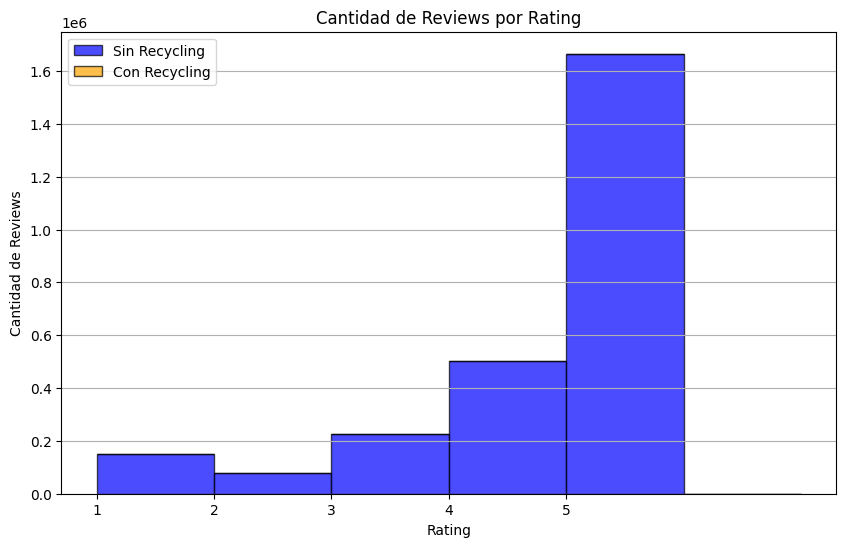

In [140]:
    # Filtrar los datos
recycling_null = df_reviewsGoogle_CA[df_reviewsGoogle_CA['Recycling'].isna()]
recycling_not_null = df_reviewsGoogle_CA[df_reviewsGoogle_CA['Recycling'].notna()]
    
    # Crear el histograma con barras apiladas
plt.figure(figsize=(10, 6))
plt.hist([recycling_null['rating'], recycling_not_null['rating']], bins=range(1, 8), edgecolor='black', alpha=0.7, label=['Sin Recycling', 'Con Recycling'], stacked=True, color=['blue', 'orange'])
plt.title('Cantidad de Reviews por Rating')
plt.xlabel('Rating')
plt.ylabel('Cantidad de Reviews')
plt.xticks(range(1, 6))  # Asegura que los ratings de 1 a 5 estén marcados en el eje x
plt.grid(axis='y')
plt.legend()
plt.show()

### Hora por categoría

<Figure size 1200x800 with 0 Axes>

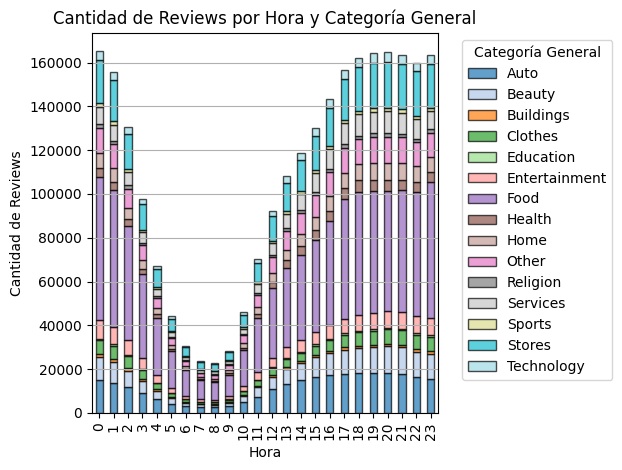

In [41]:
import matplotlib.pyplot as plt
import pandas as pd

# Asegúrate de que df_reviewsGoogle_CA tenga las columnas 'hour' y 'general_category'
# Primero, obtenemos los conteos de reviews por hora para cada categoría
hist_data = df_reviewsGoogle_CA.groupby(['hour', 'general_category']).size().unstack().fillna(0)

# Crear el histograma apilado
plt.figure(figsize=(12, 8))

# Cada categoría será representada por un color diferente
hist_data.plot(kind='bar', stacked=True, edgecolor='black', alpha=0.7, colormap='tab20')

# Personalizar el gráfico
plt.title('Cantidad de Reviews por Hora y Categoría General')
plt.xlabel('Hora')
plt.ylabel('Cantidad de Reviews')
plt.xticks(range(0, 24))  # Asegura que todas las horas de 0 a 23 estén marcadas en el eje x
plt.grid(axis='y')

# Añadir una leyenda para las categorías
plt.legend(title='Categoría General', bbox_to_anchor=(1.05, 1), loc='upper left')

# Ajustar el layout
plt.tight_layout()

# Guardar la imagen
plt.savefig('../Imagenes/EDA-GoogleMaps/reviewsxhora_por_categoria.png')

# Mostrar el gráfico
plt.show()


<Figure size 1200x800 with 0 Axes>

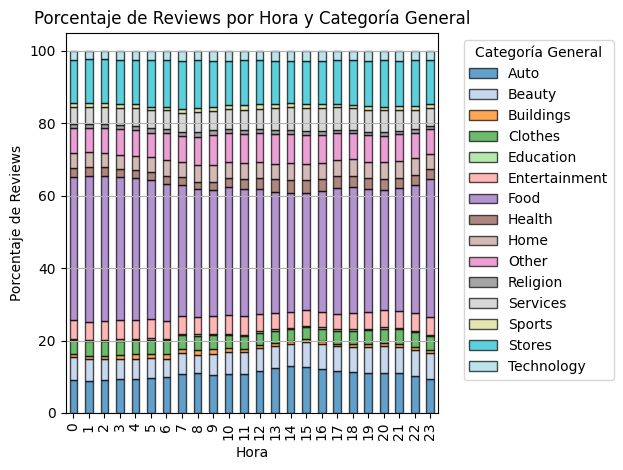

In [42]:
# Asegúrate de que df_reviewsGoogle_CA tenga las columnas 'hour' y 'general_category'
# Primero, obtenemos los conteos de reviews por hora para cada categoría
hist_data = df_reviewsGoogle_CA.groupby(['hour', 'general_category']).size().unstack().fillna(0)

# Convertir los conteos a porcentajes respecto al total de la hora
hist_data_percentage = hist_data.div(hist_data.sum(axis=1), axis=0) * 100

# Crear el histograma apilado con porcentajes
plt.figure(figsize=(12, 8))

# Cada categoría será representada por un color diferente
hist_data_percentage.plot(kind='bar', stacked=True, edgecolor='black', alpha=0.7, colormap='tab20')

# Personalizar el gráfico
plt.title('Porcentaje de Reviews por Hora y Categoría General')
plt.xlabel('Hora')
plt.ylabel('Porcentaje de Reviews')
plt.xticks(range(0, 24))  # Asegura que todas las horas de 0 a 23 estén marcadas en el eje x
plt.grid(axis='y')

# Añadir una leyenda para las categorías
plt.legend(title='Categoría General', bbox_to_anchor=(1.05, 1), loc='upper left')

# Ajustar el layout
plt.tight_layout()

# Guardar la imagen
plt.savefig('../Imagenes/EDA-GoogleMaps/reviewsxhora_por_categoria_porcentaje.png')

# Mostrar el gráfico
plt.show()


# Ciudades

In [2]:
df_reviewsGoogle_LA=pd.read_parquet('../Archivos/ReviewsGoogle_LA.parquet')
df_metadatos_LA=pd.read_parquet('../Archivos/metadatos_LA.parquet')


In [4]:
len(df_metadatos_LA)

18949